# Домашнее задание №2

Задание присылать на почту aleksartamonov@gmail.com в виде ссылки на colab

В теме письма указать **CV_PANDAN_2021 HW2 <Фамилия Имя>**

soft deadline: 08.03.2021T23:59:00+0300

hard deadline: 14.03.2021T23:59:00+0300

In [1]:
# from google.colab import drive
# drive.mount('/content/drive')

In [2]:
# %cd /content/drive/MyDrive/pandan-cv-course/practice

In [3]:
import cv2
import matplotlib.pylab as plt
import numpy as np
from ipywidgets import interact, widgets, fixed
from itertools import combinations, product, permutations
from tqdm.notebook import tqdm
import seaborn as sns
sns.set()
from joblib import Parallel, delayed
import os

%matplotlib inline
plt.style.use('default')

In [4]:
class ImgMorph:
    def __init__(self, img, name=None, gray_scaled=False):
        self.img = img
        self.name = name
        self.gray_scaled = gray_scaled
        self.histogram = None

    def change_color_space(self, tcs):
        return ImgMorph(cv2.cvtColor(self.img, tcs), gray_scaled=self.gray_scaled)

    def gray(self):
        return ImgMorph(cv2.cvtColor(self.img, cv2.COLOR_BGR2GRAY), gray_scaled=True)

    def normalize(self, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX):
        return ImgMorph(cv2.normalize(self.img, None, alpha=0, beta=255, 
                        norm_type=norm_type), gray_scaled=self.gray_scaled)

    def equalize(self):
        if self.gray_scaled:
            return ImgMorph(cv2.equalizeHist(self.img), gray_scaled=self.gray_scaled)
        else:
            channels = cv2.split(self.img)
            channels_ = []
            for chn in channels:
                channels_.append(cv2.equalizeHist(chn))
            out = cv2.merge(channels_)
            return ImgMorph(out, gray_scaled=self.gray_scaled)
            
    def threshold(self, t=0, upper=255, kind="0"):
        if kind == "0":
            c = 0
        elif kind.upper() == "THRESH_BINARY_INV":
            c = cv2.THRESH_BINARY_INV
        return ImgMorph(cv2.threshold(self.img, t, upper, c)[1], gray_scaled=self.gray_scaled)

    def open(self, kernel, iterations: int = 1):
        return ImgMorph(cv2.morphologyEx(self.img, cv2.MORPH_OPEN, kernel, iterations=iterations), gray_scaled=self.gray_scaled)

    def close(self, kernel, iterations: int = 1):
        return ImgMorph(cv2.morphologyEx(self.img, cv2.MORPH_CLOSE, kernel, iterations=iterations), gray_scaled=self.gray_scaled)

    def dilate(self, kernel):
        return ImgMorph(cv2.dilate(self.img, kernel, 0), gray_scaled=self.gray_scaled)

    def find_contours(self):
        return cv2.findContours(self.img, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

    def __add__(self, other):
        return ImgMorph((np.logical_or(self.img, other.img) * 255).astype(np.uint8))

    def calculate_histogram(self, normalize=True, num_bins=256):
        color = ("k",) if self.gray_scaled else ('b','g','r')
        histogram = []
        for i, col in enumerate(color):
            histr = cv2.calcHist([self.img], [i], None, [num_bins], [0, 256], )
            if normalize:
               histr = cv2.normalize(histr, None, alpha=0, beta=1, norm_type=cv2.NORM_MINMAX)
            histogram.append((histr, col))

        self.histogram = histogram

    def compare_histogram(self, other, distance, channel=0):
        """
        distance:
            cv2.HISTCMP_CORREL
            cv2.HISTCMP_CHISQR
            cv2.HISTCMP_INTERSECT
            cv2.HISTCMP_BHATTACHARYYA
            cv2.HISTCMP_CHISQR_ALT
            cv2.HISTCMP_KL_DIV
        """
        if self.histogram is None:
            self.calculate_histogram()
        if other.histogram is None:
            other.calculate_histogram()

        return cv2.compareHist(self.histogram[channel][0], other.histogram[channel][0], distance)

    @property
    def picture(self):
        self.show_picture(3)

    def show_picture(self, size):
        plt.figure(figsize=(size, size))
        ax = plt.axes([0, 0, 1, 1], frameon=False)
        ax.set_axis_off()
        if self.gray_scaled:
            plt.imshow(self.img, cmap="gray")
        else:
            plt.imshow(cv2.cvtColor(self.img, cv2.COLOR_BGR2RGB))

    def show_histogram(self, size=5, normalize=True):
        fig, ax = plt.subplots(1, 2, figsize=(size * 2, size))

        ax[0].set_axis_off()
        ax[0].imshow(cv2.cvtColor(self.img, cv2.COLOR_BGR2RGB))

        if self.histogram is None:
            self.calculate_histogram(normalize=normalize)

        for histr, color in self.histogram:
            ax[1].plot(histr, color=color)

        ax[1].set_xlim([0, 256])
        plt.show()

In [5]:
def grid(array, ncols=3):  
    # https://stackoverflow.com/questions/42040747/more-idiomatic-way-to-display-images-in-a-grid-with-numpy
    nindex, height, width, intensity = array.shape
    nrows = nindex // ncols
    return (array.reshape(nrows, ncols, height, width, intensity).swapaxes(1,2).reshape(height*nrows, width*ncols, intensity))

def to_plot_gamma(c, gamma, grid_size=50):
    x = np.linspace(0, 1, grid_size)
    y = c * x.astype(float) ** gamma
    return x, y

def gamma_cor(X, c, gamma):
    return (c * (X.astype(float) / 255) ** gamma * 255).astype(np.uint8)

def mse(inp, target):
    return ((inp.astype(float) - target.astype(float)) ** 2).mean()

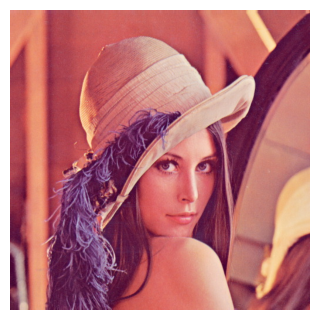

In [6]:
def show(img, size=3):
    plt.figure(figsize=(size, size))
    ax = plt.axes([0, 0, 1, 1], frameon=False)
    ax.set_axis_off()
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))

def show_gray(img, size=3):
    plt.figure(figsize=(size, size))
    ax = plt.axes([0, 0, 1, 1], frameon=False)
    ax.set_axis_off()
    plt.imshow(img, cmap="gray")

lena = ImgMorph(cv2.imread("lena.jpg"))
lena.picture


**1. (5 баллов)** С помощью [виджетов](http://ipywidgets.readthedocs.io/en/latest/examples/Widget%20List.html) создайте 2 слайдера с настройками параметров гамма-коррекции. Отобразите **lena**, ее гамма-преобразование и график в диапозоне от [0;1], так, чтобы параметры слайдера соответствовали параметрам гамма-коррекции. 

In [7]:
def lena_cor_widget(c, gamma, size=5):
    gamma_lena = gamma_cor(lena.img, c, gamma)
    
    fig, ax = plt.subplots(1, 3, figsize=(size * 3, size))

    # Original Lena
    ax[0].set_axis_off()
    ax[0].imshow(cv2.cvtColor(lena.img, cv2.COLOR_BGR2RGB))

    # Gamma-corrected Lena
    ax[1].set_axis_off()
    ax[1].imshow(cv2.cvtColor(gamma_lena, cv2.COLOR_BGR2RGB))

    # Gamma plot
    x, y = to_plot_gamma(c, gamma)
    ax[2].plot(x, y)
    ax[2].set_xlabel("x")
    ax[2].set_ylabel("$y = c\cdot x^{\\gamma}$")

    plt.show()

In [8]:
interact(lena_cor_widget, c=widgets.FloatSlider(min=0., max=1., step=0.01, value=1.), gamma=widgets.FloatSlider(min=0., max=5., step=0.01, value=1.), size=fixed(6))

interactive(children=(FloatSlider(value=1.0, description='c', max=1.0, step=0.01), FloatSlider(value=1.0, desc…

<function __main__.lena_cor_widget(c, gamma, size=5)>

**2. (5 баллов)** Загрузите изображение $lena.jpg$. Переведите изображение в градации серого. Примените к серому изображению операцию линейного растяжения диапазона яркостей ($normalize$) и эквализации гистограммы ($equalizeHist$). Постройте разность полученных результатов. Состыкуйте в одно изображение в градациях серого результат линейного растяжения, эквализации и их разности.

In [9]:
def gray_grid(array, ncols=3):
    nindex, height, width = array.shape
    nrows = nindex // ncols
    return (array.reshape(nrows, ncols, height, width).swapaxes(1,2).reshape(height*nrows, width*ncols))

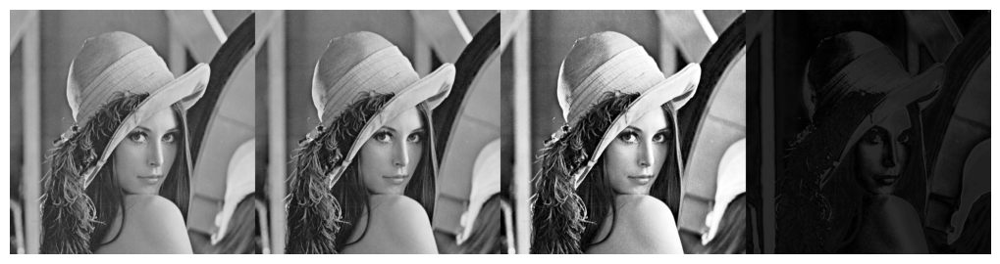

In [10]:
lena_gray = lena.gray()
lena_norm = lena_gray.normalize()
lena_eq = lena_gray.equalize()

lena_diff = np.abs(lena_norm.img.astype(float) - lena_eq.img.astype(float)).astype(np.uint8)

imgs = np.array([lena_gray.img, lena_norm.img, lena_eq.img, lena_diff])
show_gray(gray_grid(imgs, ncols=4), size=10)

**3. (5 баллов)** Реализуйте функцию добавления шума «соль и перец» для одноканального изображения. Входные параметры: $src$ – исходная одноканальная матрица $Mat$, $p$ – вероятность замещения исходных значений на $0$, $q$ – вероятность замещения исходных значений на $255$. Загрузите изображение $lena.jpg$, выделите каналы изображения в отдельные матрицы ($split$), добавьте шум «соль и перец» в каждый канал при помощи реализованной Вами функции с параметрами

1. $p=q=0.05$
2. $p=q=0.1$
3. $p=q=0.15$

In [11]:
def salt_pepper(src, p, q):
    msk = np.random.uniform(0, 1, size=src.shape)
    out = src.copy()
    out[msk <= p] = 0
    out[msk >= 1 - q] = 255
    return out

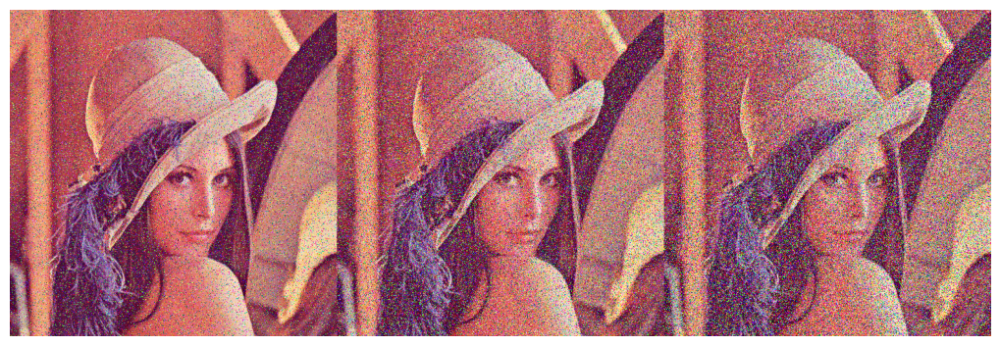

In [12]:
imgs = np.array([salt_pepper(lena.img, p=0.05, q=0.05), 
                 salt_pepper(lena.img, p=0.1, q=0.1), 
                 salt_pepper(lena.img, p=0.15, q=0.15)])
                 
show(grid(imgs), size=10)

**4. (5 баллов)** Удалите диагональные полоски с изображения $lena\_diagonal.jpg$. Вычислите среднеквадратичную ошибку (mean squared error, $MSE$) для полученного результата и изображения $lena\_gray\_512.tif$. Задача будет засчитана при $MSE < 1500$. Тот, у кого по результатам проверки будет наименьшее значение MSE среди всех студентов для этой задачи, получит призовую шоколадку (раньше мы раздавали призовые баллы, но теперь у нас концепция фиксированного максимального количества баллов)

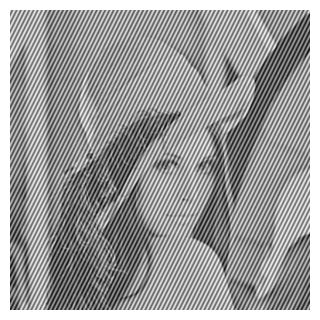

In [13]:
lena_diag = ImgMorph(cv2.imread("lena_diagonal.jpg")).gray()
lena_gray = ImgMorph(cv2.imread("lena_gray_512.tif")).gray()
lena_diag.picture

In [14]:
def undiag(img, val = 0, lower=None, upper=None, left=None, right=None):
    img_ = img.copy()
    fft = np.fft.fft2(img_)
    fft_ = fft.copy()

    if left is not None and right is not None:
        fft_[:, left:right] = val
        fft_[:, -right:-left] = val

    if lower is not None and upper is not None:
        fft_[lower:upper, :] = val
        fft_[-upper:-lower, :] = val

    return gamma_cor(np.fft.ifft2(fft_).real.astype(np.uint8), c=1, gamma=1.15)

589.7259788513184


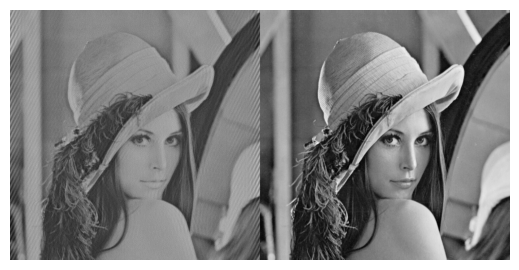

In [15]:
lena_undiag = undiag(lena_diag.img, val=46, lower=170, upper=171, left=66, right=77)
print(mse(lena_gray.img, lena_undiag))

show_gray(gray_grid(np.array([lena_undiag, lena_gray.img]), 2), 5)

**4. (5 баллов)** Подавите шум на изображении $lena\_color\_512\_noise.tif$. Вычислите среднеквадратичную ошибку ($MSE$) для полученного результата и изображения $lena\_color\_512.tif$. Задача будет засчитана при $MSE < 150$. Тот, у кого по результатам проверки будет наименьшее значение $MSE$ среди всех студентов для этой задачи, получит призовую шоколадку.

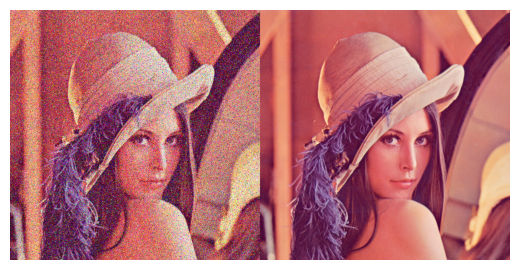

In [16]:
lena_noised = cv2.imread("lena_color_512-noise.tif")
lena_target = cv2.imread("lena_color_512.tif")
show(grid(np.array([lena_noised, lena_target]), 2), size=5)

In [17]:
def experiment(img, cv2blurs, size=3, d=9, sigma_color=75, h=3, h_color=3, tws=7, sws=21, sigma_space=75):
    params = {
        "cv2blurs": cv2blurs,
        "size": size,
        "d": d,
        "sigma_color": sigma_color,
        "sigma_space": sigma_space,
    }
    out = img.copy()
    for flt in cv2blurs:
        if flt == "blur":
            out = cv2.blur(out, (size, size))
        elif flt == "medianBlur":
            out = cv2.medianBlur(out, size)
        elif flt == "GaussianBlur":
            out = cv2.GaussianBlur(out, (size, size), 0)
        elif flt == "bilateralFilter":
            out = cv2.bilateralFilter(out, d, sigma_color, sigma_space)
        elif flt == "fastNlMeansDenoisingColored":
            out = cv2.fastNlMeansDenoisingColored(out, h, h_color, tws, sws)

    return out.astype(np.uint8)

def collect_data(inp, target, **kwargs):
    result = experiment(inp, **kwargs)
    return mse(result, lena_target), kwargs

MSE: 82.33396021525066 < 150


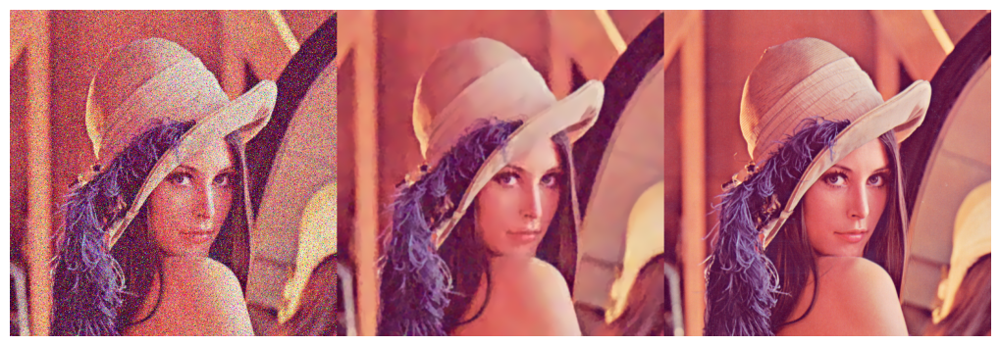

In [18]:
cfg = {'cv2blurs': ('medianBlur', 'GaussianBlur', 'fastNlMeansDenoisingColored', 'bilateralFilter'), 'size': 3, 'd': 15, 'sigma_color': 20, 'sigma_space': 100, 'h': 3, 'h_color': 5, 'tws': 5, 'sws': 21}
result = experiment(lena_noised, **cfg)
print("MSE:", mse(result, lena_target), "< 150")

imgs = np.array([lena_noised, result, lena_target])
show(grid(imgs, 3), 10)

**5. (5 баллов)** Выделите в изображении $table.jpg$ границы таблицы с использованием морфологических операций. Результатом обработки должно быть изображение, в котором удален весь текст и оставлены только границы таблицы

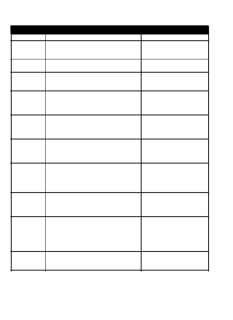

In [19]:
table = ImgMorph(cv2.imread("table.jpg"))

kernel = np.ones((2, 2), np.uint8)
clean_header = table.open(kernel)

kernel_v = np.ones((8, 1), np.uint8)
vertical_part = clean_header.close(kernel_v)

kernel = np.ones((1, 3), np.uint8)
horizontal_part = table.close(kernel, iterations=5)

table_corpse = (vertical_part.threshold(t=128, kind="THRESH_BINARY_INV") 
              + horizontal_part.threshold(t=128, kind="THRESH_BINARY_INV")).threshold(t=128, kind="THRESH_BINARY_INV")
table_corpse.picture

**6. (5 баллов)** Отделите монеты от фона на изображении $coins\_1.jpg$, отсортируйте монеты по убыванию размера. Сгенерируйте результирующее изображение с цветной разметкой областей, соответствующих монетам на исходном изображении: на черном фоне должны быть выделены разными цветами области, соответствующие монетам. В центре каждой выделенной области разместите порядковый номер монеты в соответствии с сортировкой монет по размеру (в центре области, соответствующей самой большой монете, должно стоять число 1)

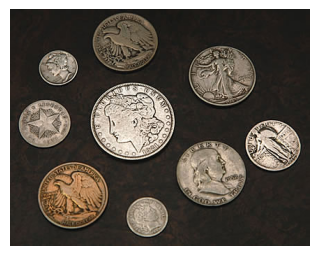

In [20]:
coins_1 = cv2.imread("coins_1.jpg")
coins = ImgMorph(coins_1)
coins.picture

<ipython-input-21-8bdda9333b70>:13: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  cns = np.array(cns)


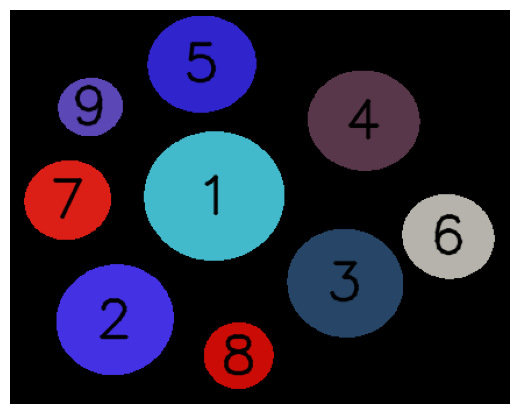

In [21]:
result = np.zeros_like(coins.img, dtype=np.uint8)

test = coins.gray().threshold(t=55)
contours, _ = test.find_contours()

cns = []
for cnt in contours:
    if len(cnt) > 75:
        cns.append(cv2.fitEllipse(cnt))

# list-of-tuples --> np.array is not good, not good at all but
# I do not know how to overcome this laconically
cns = np.array(cns)

cns = cns[np.argsort(list(map(lambda x: np.prod(x), cns[:, 1])))[::-1]]
for cnt in cns:
    color = map(int, np.random.randint(0, 255, 3))
    cv2.ellipse(result, tuple(cnt), tuple(color), -1)

for idx, cnt in enumerate(cns):
    cv2.putText(result, str(idx + 1), tuple(np.array(cnt[0]).astype(int) + [-15, 15]), 
                cv2.FONT_HERSHEY_SIMPLEX, 1.5, (0, 0, 0), 2, cv2.LINE_AA)

show(result, size=5)

**7. (5 баллов)** Отделите монеты от текста на изображении $coins\_2.jpg.$ Сгенерируйте по входному изображению два изображения: на одном должны остаться только монеты, весь текст должен быть удален; на втором изображении должен остаться только текст, все монеты должны быть удалены.

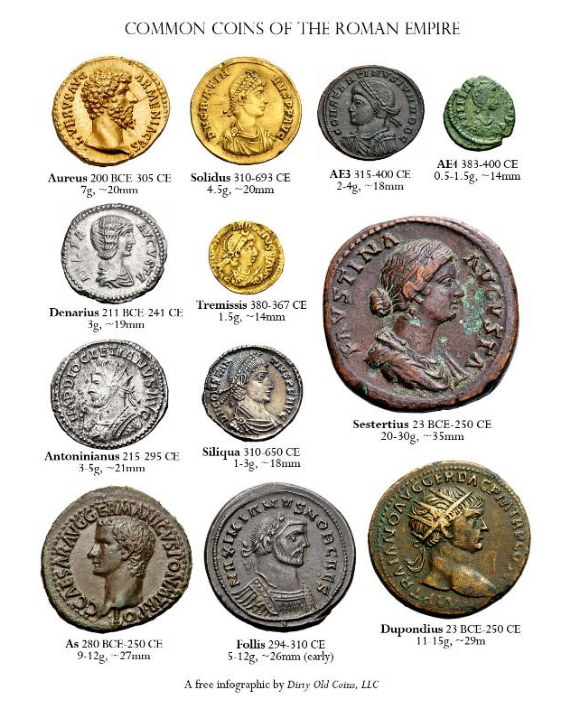

In [22]:
coins_2 = cv2.imread("coins_2.jpg")
coins = ImgMorph(coins_2)
coins.show_picture(7)

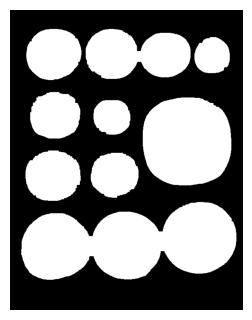

In [23]:
open_kernel = np.ones((5, 5), dtype=np.uint8)
close_kernel = np.ones((20, 20), dtype=np.uint8)
dilation_kernel = np.ones((9, 11), dtype=np.uint8)

coins2 = coins.gray() \
        .threshold(t=235) \
        .threshold(t=128, kind="THRESH_BINARY_INV") \
        .open(open_kernel) \
        .close(close_kernel) \
        .dilate(dilation_kernel)
coins2.picture

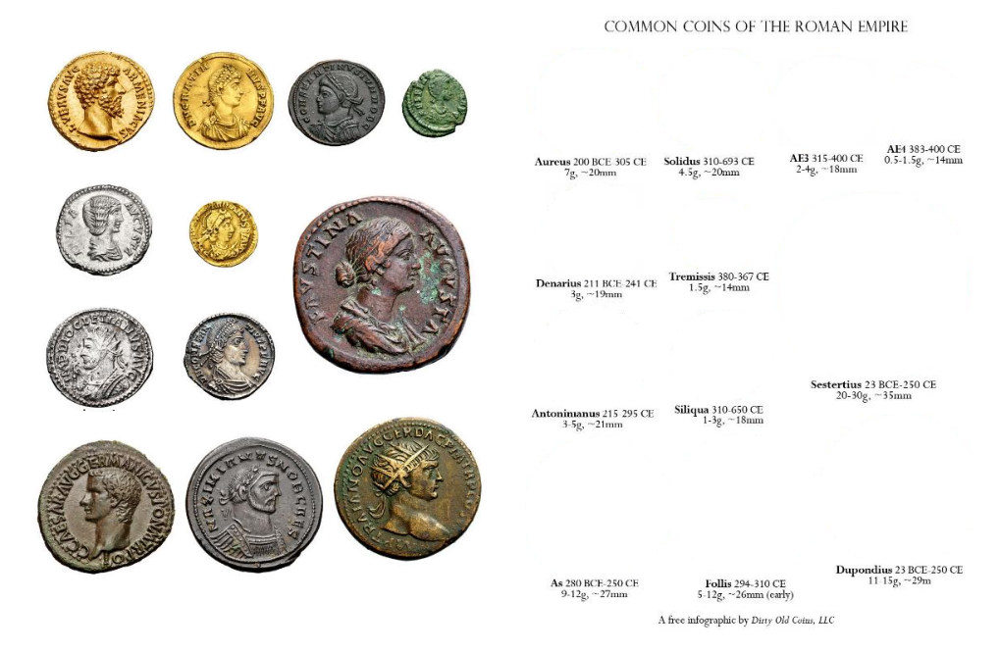

In [24]:
result_coins = coins.img.copy()
result_coins[coins2.img <= 128] = 255

result_text = coins.img.copy()
result_text[coins2.img > 128] = 255

imgs = np.array([result_coins, result_text])

show(grid(imgs, 2), size=10)

**8. (10 баллов)** Посмотрите на изображения в папке *Coral*. Посчитайте гистограммы изображений. Выведите на экран 20 пар изображений с максимально похожими гистограммами. В этом задании надо попробовать:
* различные цветовые пространства (RGB, HSV, CIELab)
* различные способы разбиения на бины (разное количество для каждой характеристики)
* различные метрики сравнения $L_2$, $\chi^2$, пересечение гистограм

Приведите результат для лучшей комбинации признаков.

In [25]:
class MyDataset:
    def __init__(self, path_to_dataset, **kwargs):
        self.photo_names = os.listdir(path_to_dataset)
        self.path_base = path_to_dataset
    
    def __getitem__(self, index):
        name = self.photo_names[index]
        path = self.path_base + "/" + name
        return ImgMorph(cv2.imread(path), name=name)
    
    def __len__(self):
        return len(self.photo_names)

In [26]:
db = MyDataset("datasets/Corel")

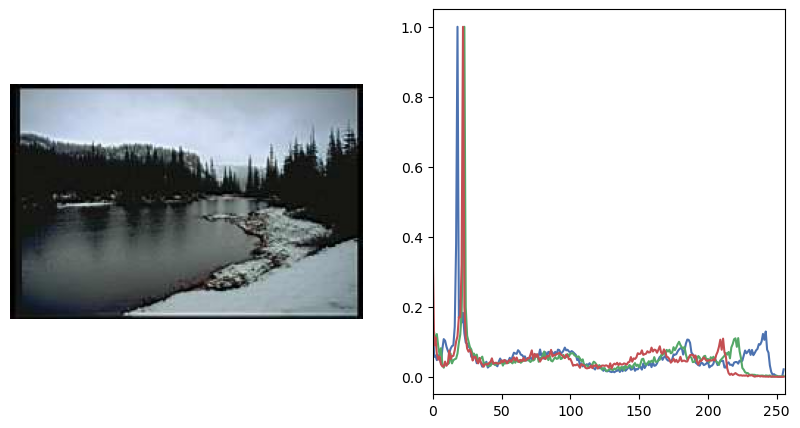

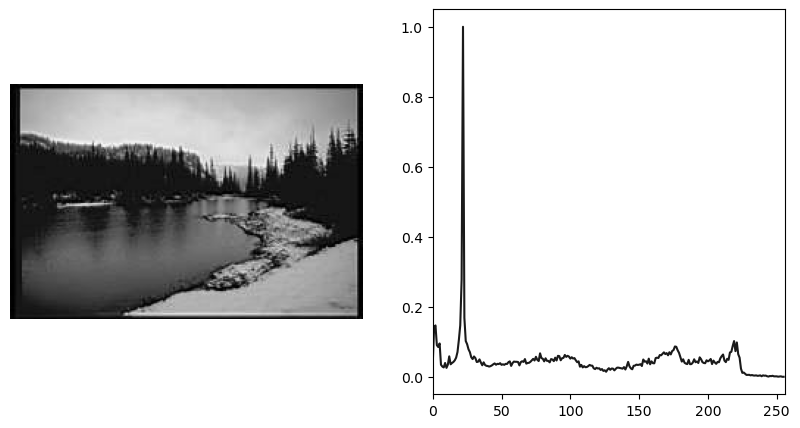

In [27]:
img = db[0]

img.show_histogram()
img.gray().show_histogram()

color spaces:

    cv2.COLOR_BGR2RGB

    cv2.COLOR_BGR2HSV

    cv2.COLOR_BGR2LAB


distance:

    cv2.HISTCMP_CORREL

    cv2.HISTCMP_CHISQR

    cv2.HISTCMP_INTERSECT

    cv2.HISTCMP_BHATTACHARYYA

    cv2.HISTCMP_CHISQR_ALT

    cv2.HISTCMP_KL_DIV

In [28]:
def get_top(stat, num=20, reverse=False):
    img1_lst, img2_lst, scores = stat
    idxs = np.argsort(-scores)[:num] if reverse else np.argsort(scores)[:num]
    return img1_lst[idxs], img2_lst[idxs], scores[idxs]

def show_top(db, stat, num=20, size=5, reverse=False):
    top = get_top(stat, num=num, reverse=reverse)

    for idx1, idx2, score in zip(*top):
        img1 = db[idx1]
        img2 = db[idx2]
        img1.calculate_histogram()
        img2.calculate_histogram()

        fig, ax = plt.subplots(1, 3, figsize=(size * 3, size))

        ax[0].set_axis_off()
        ax[0].imshow(cv2.cvtColor(img1.img, cv2.COLOR_BGR2RGB))

        ax[1].set_axis_off()
        ax[1].imshow(cv2.cvtColor(img2.img, cv2.COLOR_BGR2RGB))

        for histr, color in img1.histogram:
            hst = histr.flatten()
            ax[2].fill_between(np.arange(hst.shape[0]), 0, hst, color=color, alpha=0.4)

        for histr, color in img2.histogram:
            hst = histr.flatten()
            ax[2].fill_between(np.arange(hst.shape[0]), 0, hst, color=color, alpha=0.4)
        plt.show()


def get_stat(db, distance, tcs=None):
    img1_lst, img2_lst, scores = [], [], []

    for idx1 in range(len(db)):
        img1 = db[idx1]
        for idx2 in range(idx1 + 1, len(db)):
            img2 = db[idx2]
            score = 0.

            if tcs is not None:
                img1 = img1.change_color_space(tcs)
                img2 = img2.change_color_space(tcs)

            for ch in range(3):
                score_ch = img1.compare_histogram(img2, distance=distance, channel=ch)
                score += score_ch

            img1_lst.append(idx1)
            img2_lst.append(idx2)
            scores.append(score)
    return np.array(img1_lst), np.array(img2_lst), np.array(scores)

In [29]:
NUM = 3

RGB


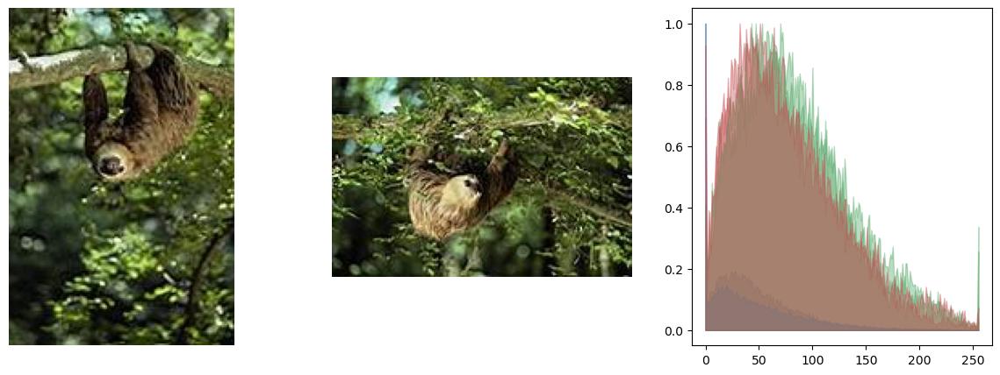

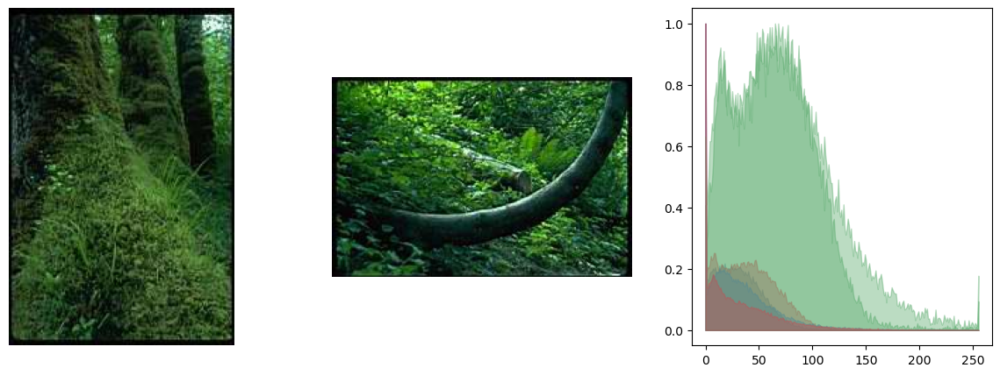

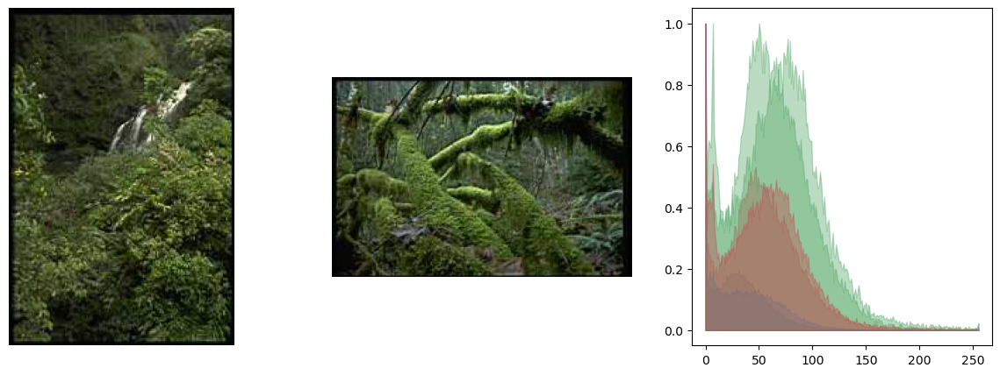

HSV


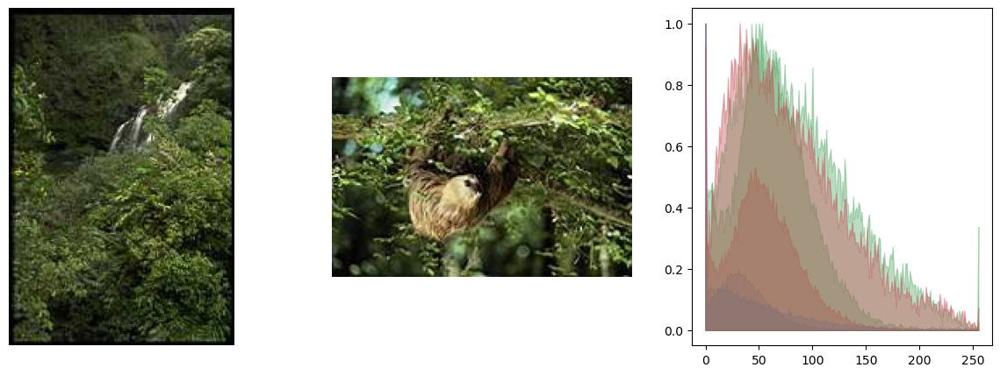

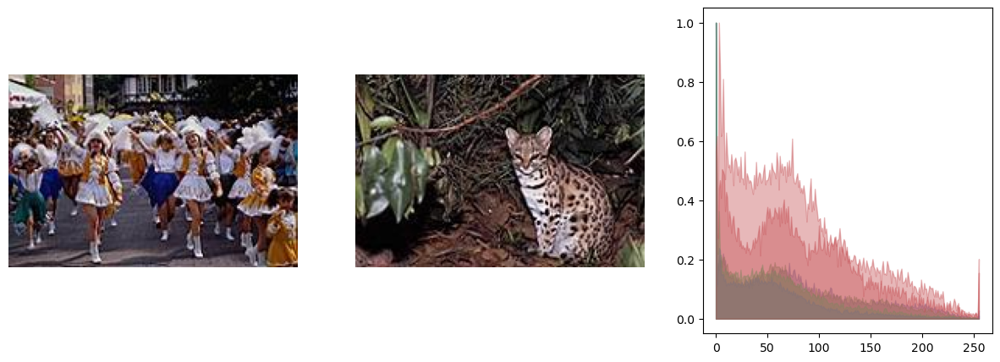

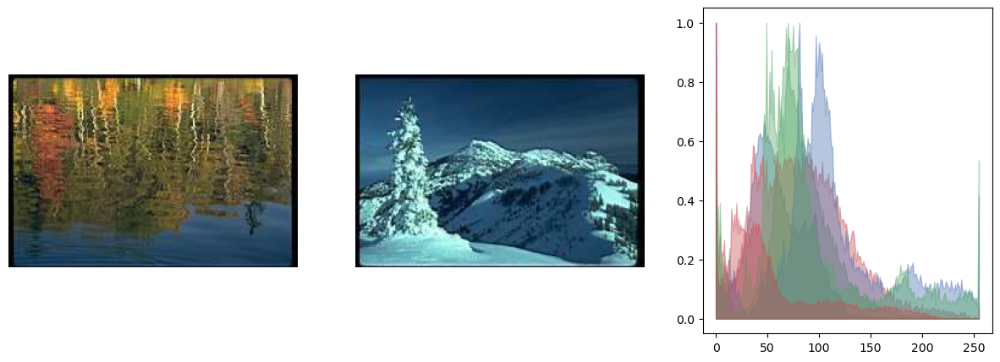

LAB


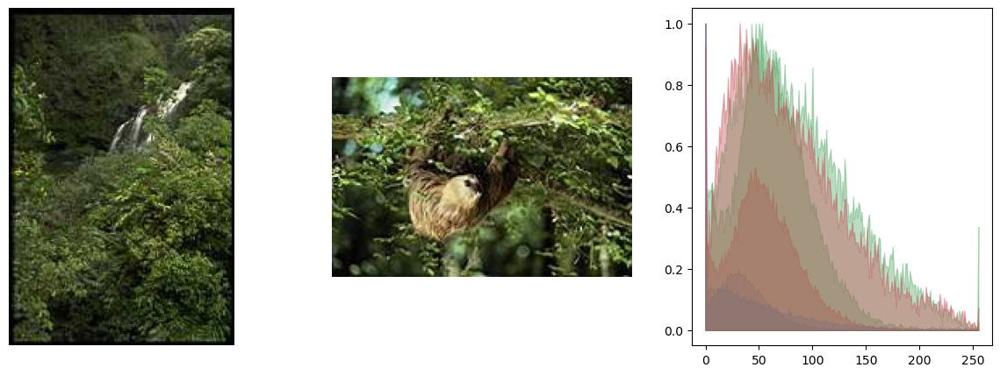

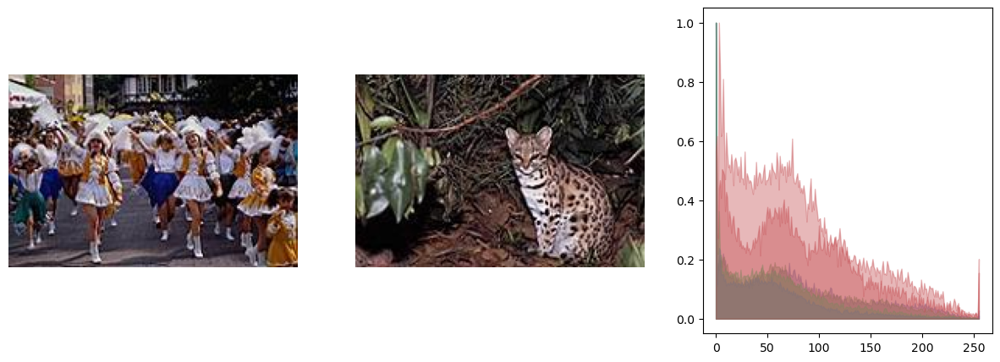

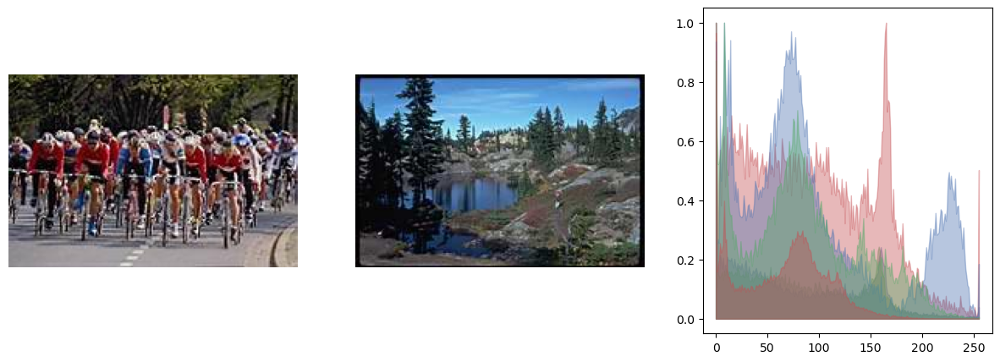

In [30]:
dist = cv2.HISTCMP_CORREL

print("RGB")
show_top(db, get_stat(db, dist, tcs=cv2.COLOR_BGR2RGB), num=NUM, reverse=True)

print("HSV")
show_top(db, get_stat(db, dist, tcs=cv2.COLOR_BGR2HSV), num=NUM, reverse=True)

print("LAB")
show_top(db, get_stat(db, dist, tcs=cv2.COLOR_BGR2LAB), num=NUM, reverse=True)

CORREL: 
* RGB ничего так
* HSV чет странное
* Lab тоже ниче так

RGB


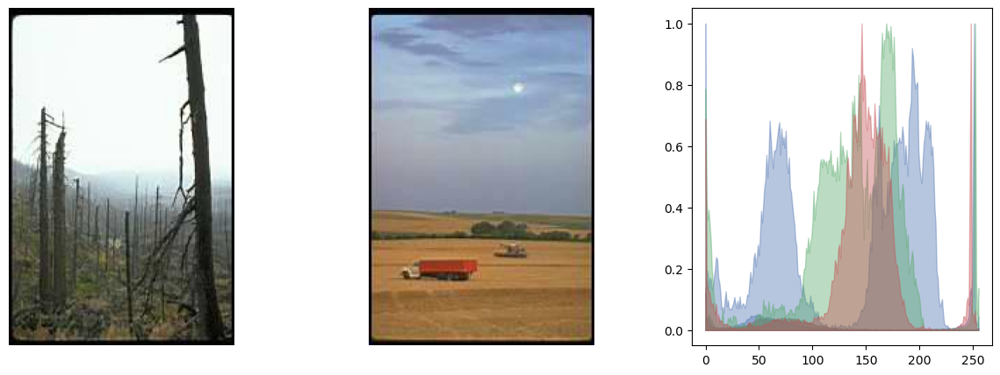

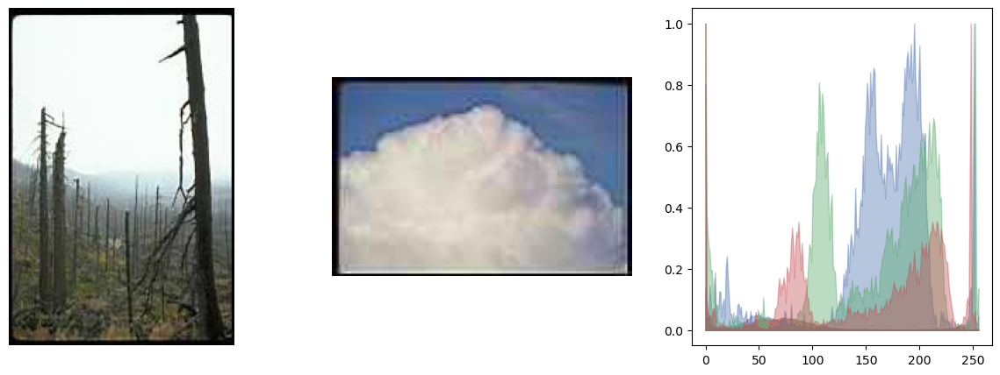

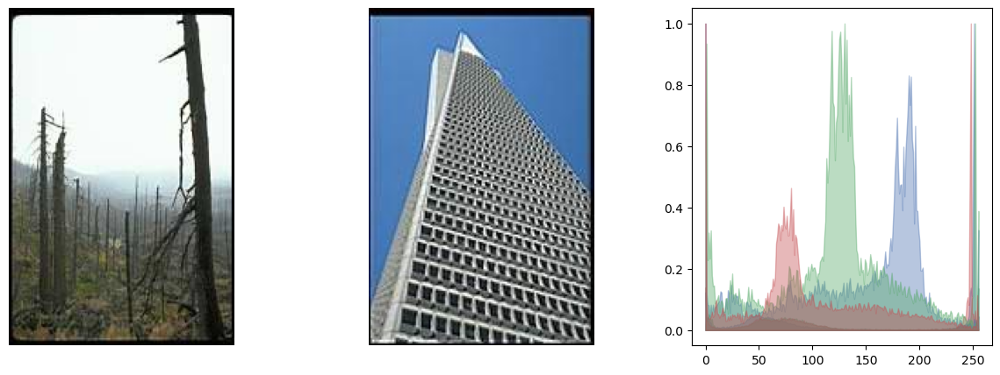

HSV


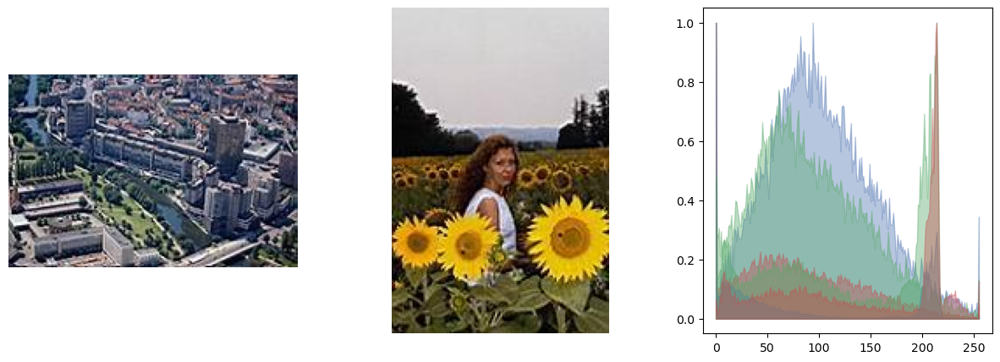

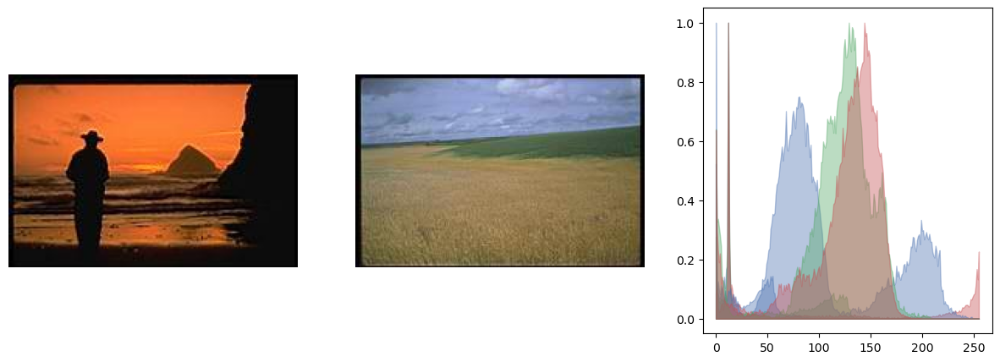

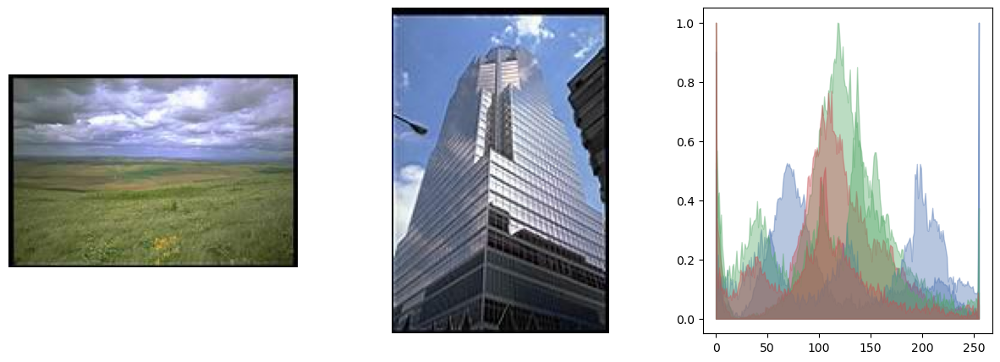

LAB


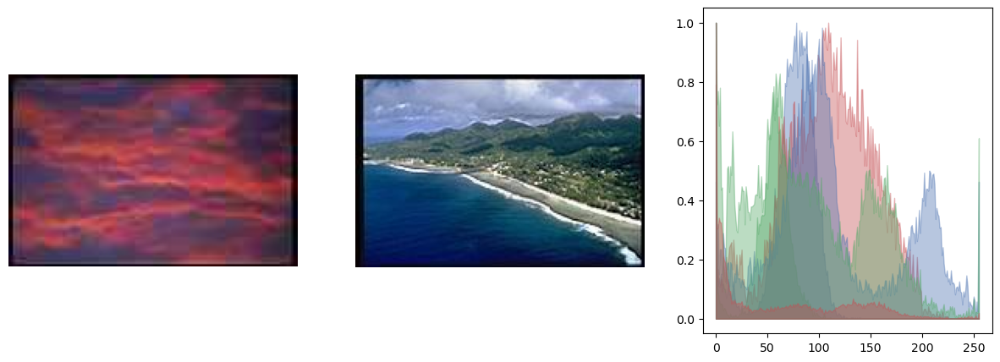

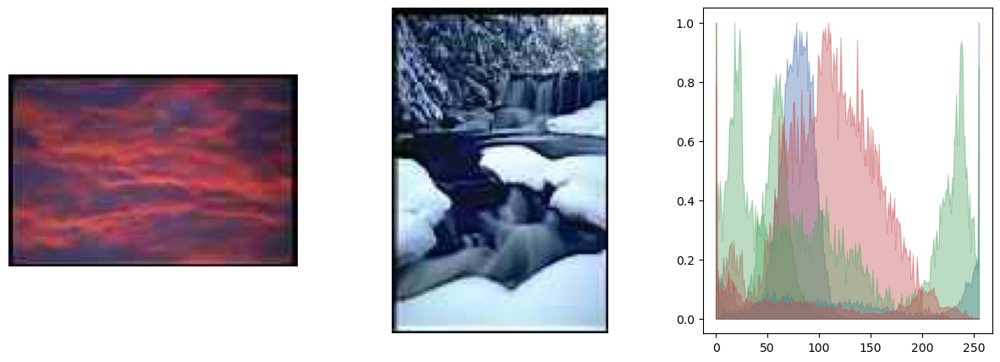

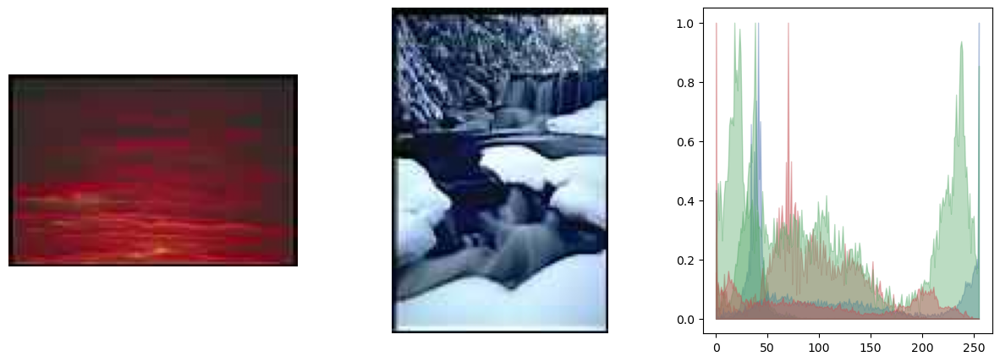

In [31]:
dist = cv2.HISTCMP_CHISQR

print("RGB")
show_top(db, get_stat(db, dist, tcs=cv2.COLOR_BGR2RGB), num=NUM)

print("HSV")
show_top(db, get_stat(db, dist, tcs=cv2.COLOR_BGR2HSV), num=NUM)

print("LAB")
show_top(db, get_stat(db, dist, tcs=cv2.COLOR_BGR2LAB), num=NUM)

$\chi^2$ мне не нравится

RGB


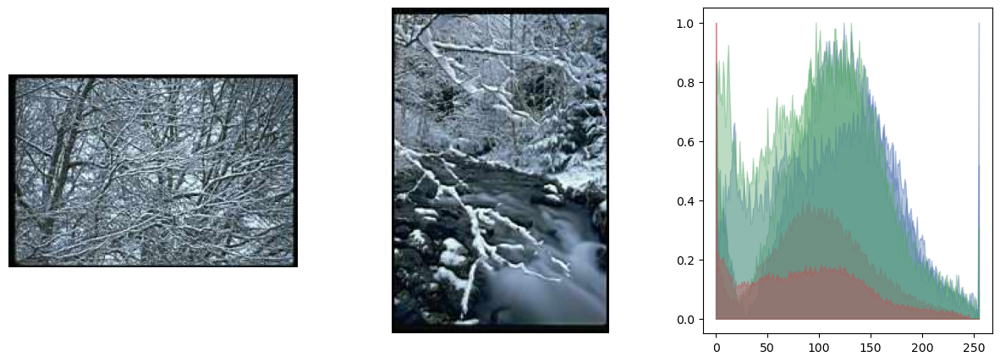

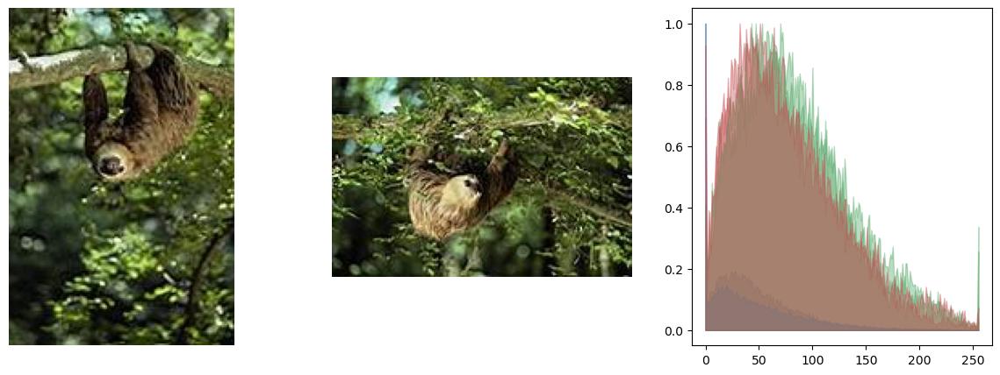

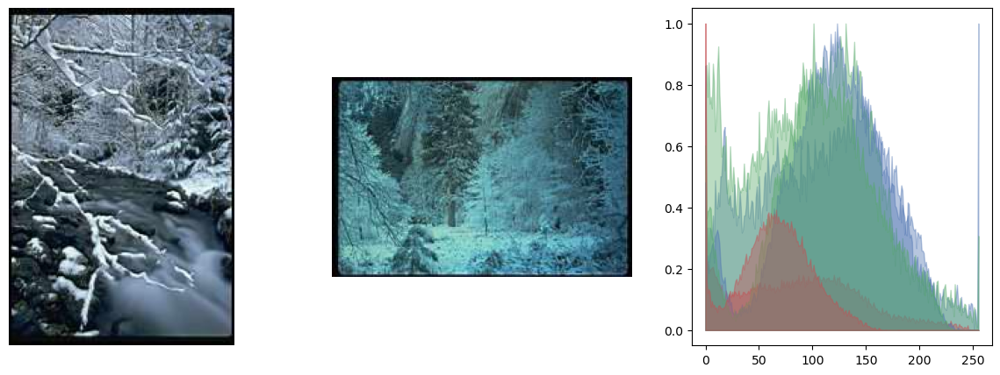

HSV


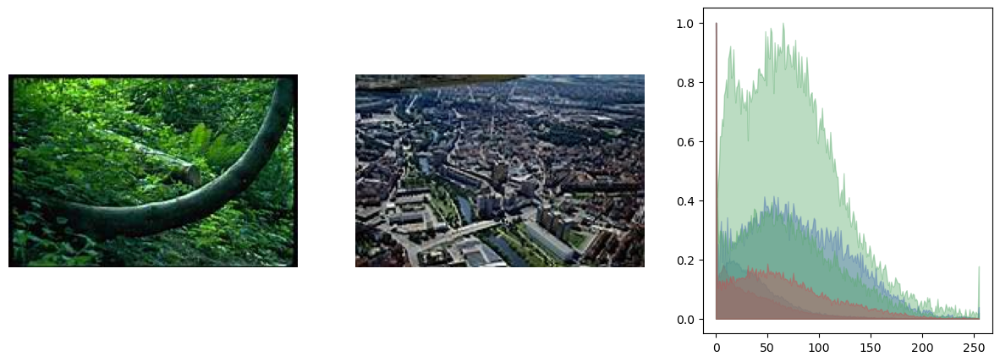

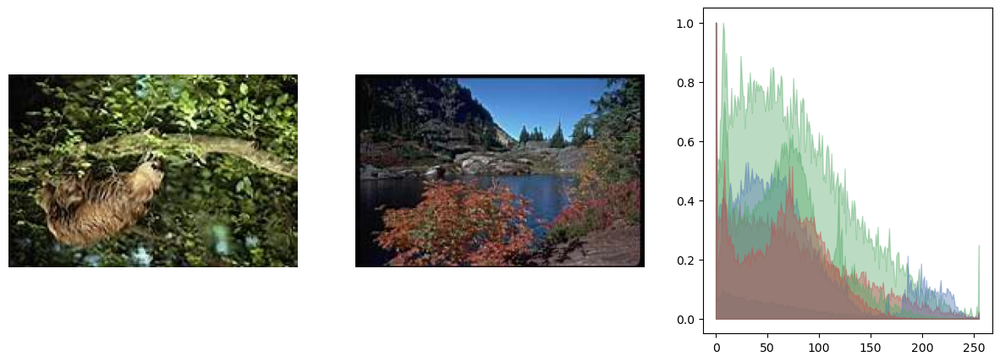

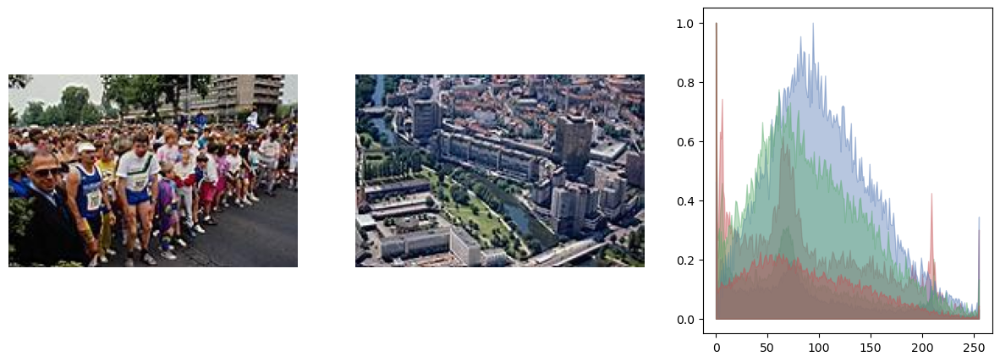

LAB


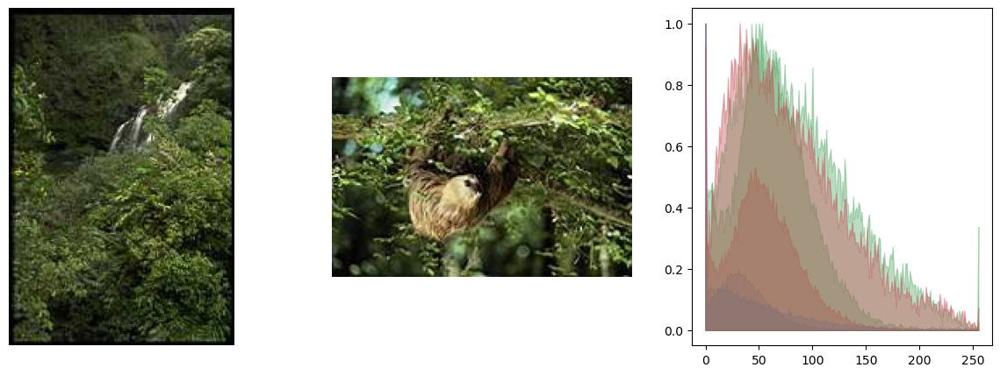

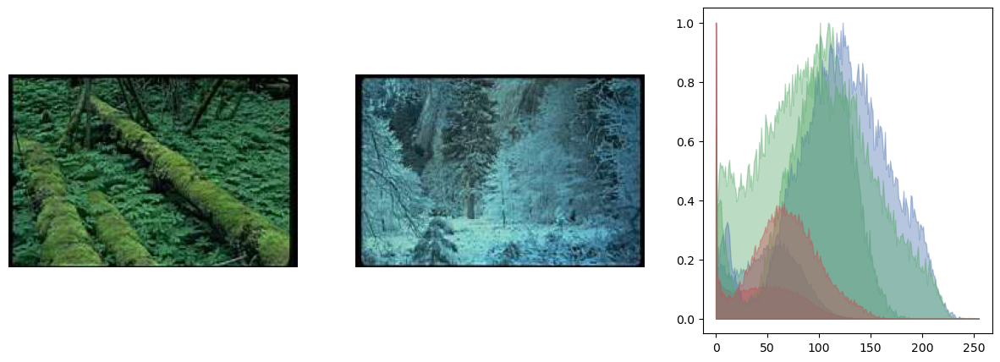

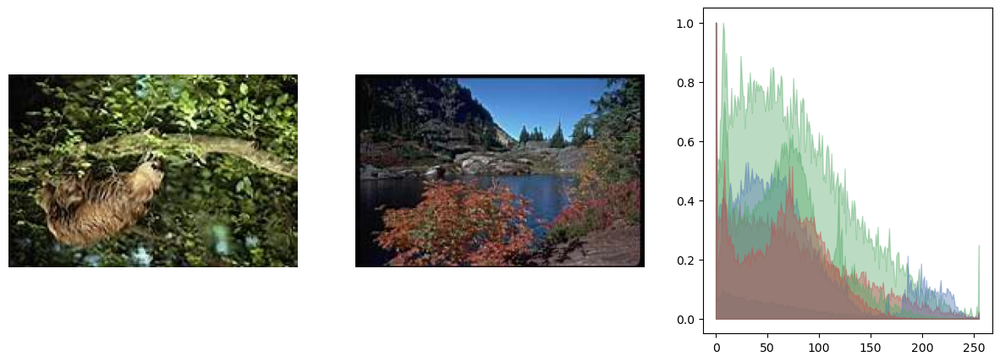

In [32]:
dist = cv2.HISTCMP_INTERSECT

print("RGB")
show_top(db, get_stat(db, dist, tcs=cv2.COLOR_BGR2RGB), num=NUM, reverse=True)

print("HSV")
show_top(db, get_stat(db, dist, tcs=cv2.COLOR_BGR2HSV), num=NUM, reverse=True)

print("LAB")
show_top(db, get_stat(db, dist, tcs=cv2.COLOR_BGR2LAB), num=NUM, reverse=True)

INTERSECT тоже не нравится

In [ ]:
dist = cv2.HISTCMP_BHATTACHARYYA

print("RGB")
show_top(db, get_stat(db, dist, tcs=cv2.COLOR_BGR2RGB), num=NUM)

print("HSV")
show_top(db, get_stat(db, dist, tcs=cv2.COLOR_BGR2HSV), num=NUM)

print("LAB")
show_top(db, get_stat(db, dist, tcs=cv2.COLOR_BGR2LAB), num=NUM)

Дальше идет лучшая по субъективному мнению (хотя ожидал, что HSV будет работать лучше)

In [ ]:
dist = cv2.HISTCMP_CORREL

print("RGB")
show_top(db, get_stat(db, dist, tcs=cv2.COLOR_BGR2RGB), num=20, reverse=True)

**10. (10 баллов)** Посмотрите на изображения в папке *leaves*. Посчитайте дескрипторы Фурье для каждого листочка изображений. Выведите на экран 20 пар изображений с максимально похожими дескрипторами.

In [ ]:
class FourierDescriptor:
    def __init__(self, contour):
        self.contour = contour == 0

        self.coords = None
        self.center = None
        self.distances = None
        self.angles = None
        self.points = None
        
    def calculate_center(self):
        self.center = np.mean(self.coords, axis=0).astype(int)

    def calculate_coords(self):
        self.coords = np.vstack(np.where(self.contour)).T

    def transfrom_coords(self):
        self.coords -= self.center

    def calculate_distances(self):
        self.distances = np.linalg.norm(self.coords, axis=1)

    def calculate_angels(self, num):
        self.angles = np.arccos(self.coords[:, 1] / self.distances)
        self.angles[self.coords[:, 0] < 0] = 2 * np.pi - self.angles[self.coords[:, 0] < 0]

        # чет запутался как отловить все кейсы на дурака
        # idxs = []
        # angles_ = np.linspace(0, 2 * pi, num, endpoint=False)
        # for angle in angles_:
        #     idx = np.agrmin(np.abs(self.angles - angle))
        #     while idx in idxs and idx < len(self.angles):
        #         idx += 1
        #     idxs.append(idx)

        self.points = np.argsort(self.angles)[np.linspace(0, self.angles.shape[0], num=num, dtype=int, endpoint=False)]

    def get_descriptor(self, num=50):
        self.calculate_coords()
        self.calculate_center()
        self.transfrom_coords()
        self.calculate_distances()
        self.calculate_angels(num=num)

        distances = self.distances[self.points]

        n = distances.shape[0]
        coefs = np.array([distances.dot(np.exp(-complex(0, 1) * 2 * np.pi * k * np.arange(n) / n)) / n for k in range(n)])

        coefs = np.absolute(coefs)
        return (coefs / coefs[0])[1:]

In [ ]:
def show_images(*images, size=(10, 5)):
    fig, axes = plt.subplots(1, len(images), figsize=size)
    for ax, im in zip(axes, images):
        ax.set_axis_off()
        ax.imshow(cv2.cvtColor(im, cv2.COLOR_BGR2RGB))


def get_stat_fourier(db, num, num_coefs):
    n = len(db)

    score_mtx = np.ones(shape=(n, n)) * 1e6

    for i in range(n - 1):
        img1 = db[i]
        coef1 = FourierDescriptor(img1.gray().img).get_descriptor(num=num_coefs)
        for j in range(i + 1, n):
            img2 = db[j]
            coef2 = FourierDescriptor(img2.gray().img).get_descriptor(num=num_coefs)
            score_mtx[i, j] = mse(coef1, coef2)

    idx = np.unravel_index(np.argsort(score_mtx, axis=None), score_mtx.shape)
    ii, jj = idx[0][:num], idx[1][:num]

    return np.vstack((ii, jj)).T

In [ ]:
leaves = MyDataset("datasets/leaves")

for i, j in get_stat_fourier(leaves, 20, 50):
    show_images(leaves[i].img, leaves[j].img, size=(6, 3))